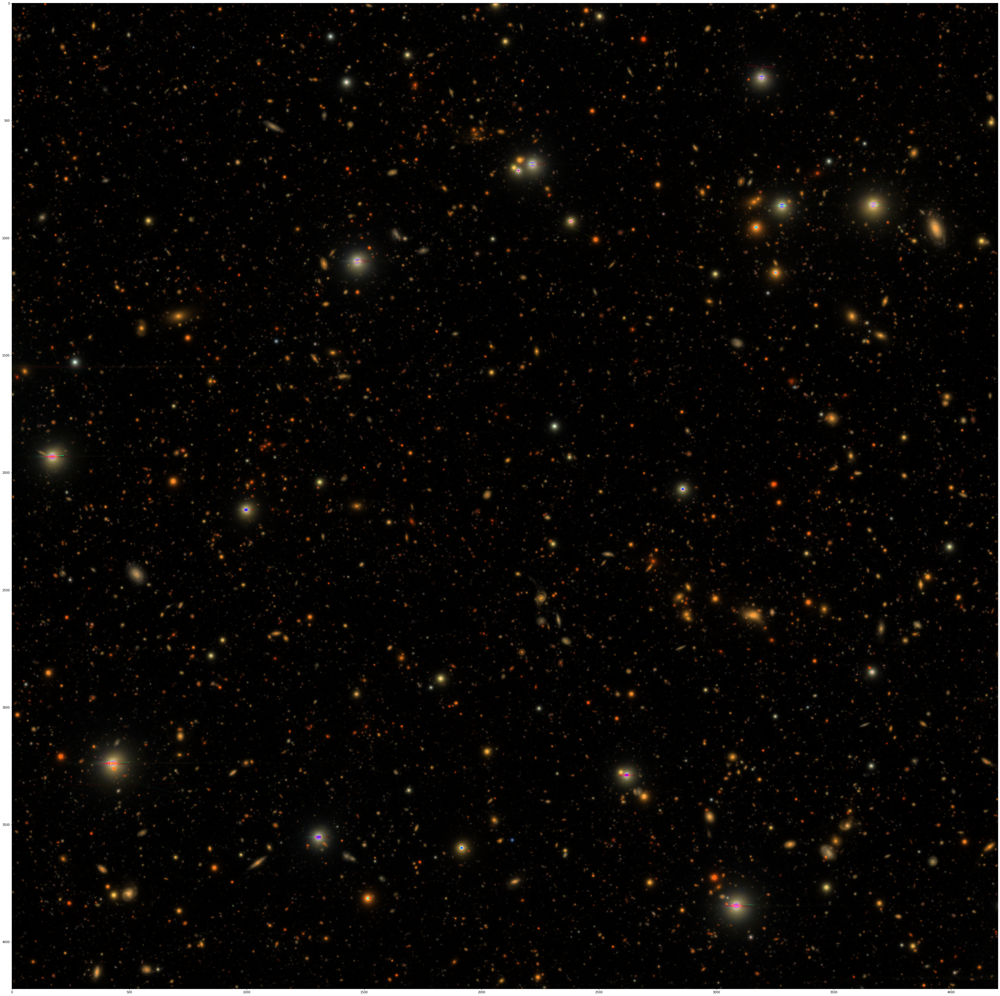

In [40]:
# Import Packages and setup
import numpy as np
import scarlet
import scarlet.display
import astropy.io.fits as fits
from astropy.wcs import WCS
from scarlet.display import AsinhMapping
from MuSCADeT import MCA 
from minisom import MiniSom
%matplotlib inline

import matplotlib
import matplotlib.pyplot as plt
# use a better colormap and don't interpolate the pixels
matplotlib.rc('image', cmap='gist_stern')
matplotlib.rc('image', interpolation='none')

In [2]:
# Load the HSC image data
obs_hdu = fits.open('/Users/remy/Desktop/LSST_Project/scarlet/data/test_resampling/Cut_HSC.fits')
data_hsc = obs_hdu[0].data.byteswap().newbyteorder()
wcs_hsc = WCS(obs_hdu[0].header)
channels_hsc = ['g','r','i','z','y']

# Load the HSC PSF data
psf_hsc = fits.open('/Users/remy/Desktop/LSST_Project/scarlet/data/test_resampling/PSF_HSC.fits')[0].data
Np1, Np2 = psf_hsc[0].shape
psf_hsc = scarlet.PSF(psf_hsc)

In [3]:
hsc_sq = np.sqrt(np.sum(data_hsc**2, 0))
 
data_hscnorm = data_hsc /hsc_sq[np.newaxis, :,:]

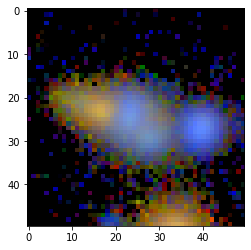

In [4]:
# Create a color mapping for the HSC image
hsc_norm = AsinhMapping(minimum=0, stretch=1, Q=10)
# Map the HSC image to RGB
img_rgb = scarlet.display.img_to_rgb(data_hsc, norm=hsc_norm)
plt.imshow(img_rgb)
plt.show()

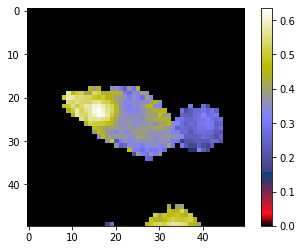

In [5]:
map_hsc = np.sum(data_hsc, 0)
noise = MCA.MAD(map_hsc)

map_hsc[map_hsc < 10*noise] = 0

vectors = data_hscnorm[:,map_hsc > 0]
data_hscnorm[:,map_hsc <= 0] = 0
plt.imshow(data_hscnorm[3])
plt.colorbar()
plt.show()

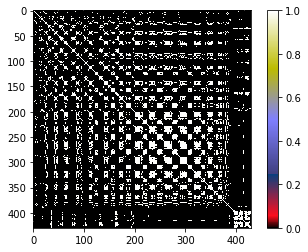

In [6]:
scalar_prod = np.sum(vectors[:,np.newaxis, :] * vectors[:,:,np.newaxis], axis = 0)

scalar_prod[scalar_prod<0.99] = 0
plt.imshow((scalar_prod))
plt.colorbar()
plt.show()


In [7]:
scal = scalar_prod
y, x = np.where(map_hsc >= 10*noise)
def make_colours(cor_mat, thresh):
    count = 0
    colours = []
    
    pic = np.zeros((data_hsc.shape[-2:]))
    while np.shape(cor_mat)[0] > 0:
        mask = cor_mat[0]
        inds = []
        for i, s in enumerate(cor_mat):
            if np.sum(mask*s) > thresh:
                mask *= s
                inds.append(i)
    
        if np.size(inds) < thresh:
            cor_mat = np.delete(cor_mat, 0, axis = 0)
        else:
            cor_mat = np.delete(cor_mat, inds, axis = 0)
            colours.append(mask)
    return np.array(colours) 

colours = make_colours(scalar_prod, 5)


print(np.shape(colours))

(22, 430)


In [14]:
#col = np.zeros((colours.shape[0], data_hsc.shape[1], data_hsc.shape[2]))
#col[:,y,x] = colours

#for c in col:
#    img_rgb = scarlet.display.img_to_rgb(data_hsc*(c[np.newaxis,:,:])/np.max(c), norm=hsc_norm)
#    plt.imshow(img_rgb)
#    plt.show()

In [9]:
y, x = np.where(map_hsc >= 10*noise)
print(scalar_prod.shape)
shell = np.zeros((scalar_prod.shape[0],data_hsc.shape[1], data_hsc.shape[2]))
for i in range(scalar_prod.shape[0]):
    shell[i, y, x] = scalar_prod[i]

    #plt.imshow(shell[i])
    #plt.plot(x[i], y[i], 'or')
    #plt.colorbar()
    #plt.show()

(430, 430)


In [10]:
##Self organising maps
from sklearn import datasets
from sklearn.preprocessing import scale

In [11]:
n,n1,n2 = shell.shape
N = 15
# load the digits dataset from scikit-learn
data = scale(shell.reshape(n,n1*n2))

som = MiniSom(N,N, n1*n2, sigma=4,
              learning_rate=0.5, neighborhood_function='gaussian')
som.pca_weights_init(data)
print("Training...")
som.train_random(data, 5000, verbose=True)  # random training
print("\n...ready!")

Training...
 [ 5000 / 5000 ] 100% - 0:00:00 left 
 quantization error: 0.06568302509837094
 topographic error: 0.01627906976744186

...ready!


/anaconda3/lib/python3.7/site-packages/matplotlib/collections.py:857: RuntimeWarning: invalid value encountered in sqrt
  scale = np.sqrt(self._sizes) * dpi / 72.0 * self._factor


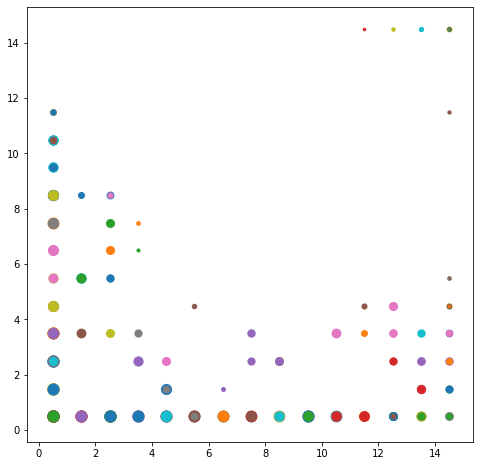

In [12]:

plt.figure(figsize=(8, 8))
wmap = {}
im = 0
for x in data:  # scatterplot
    w = som.winner(x)
    wmap[w] = im
    plt.scatter(w[0]+.5,  w[1]+.5, np.sum(x))
    im = im + 1

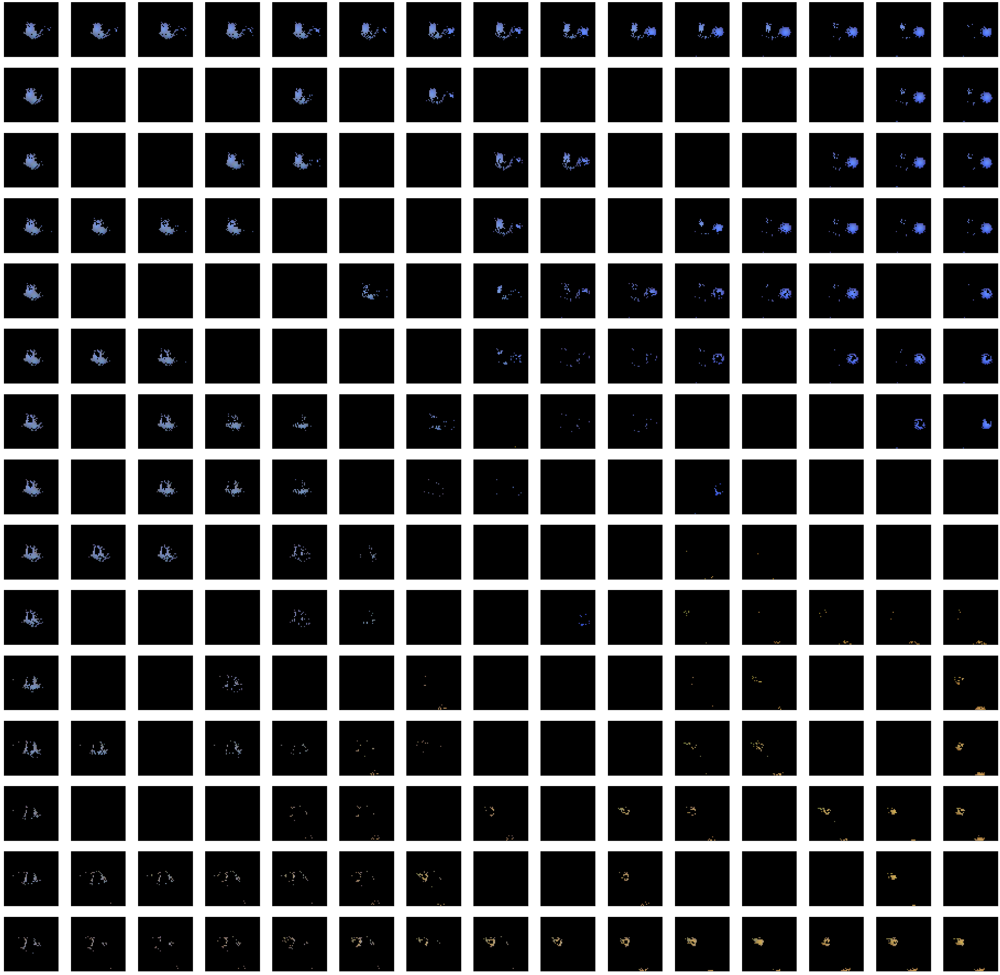

In [13]:
plt.figure(figsize=(50, 50), facecolor='white')
cnt = 0
for j in range(N):  # images mosaic
    for i in range(N):
        plt.subplot(N,N, cnt+1,  xticks=[],  yticks=[])
        if (i, j) in wmap:
            img_rgb = scarlet.display.img_to_rgb(data_hsc*shell[wmap[(i, j)]][np.newaxis,:,:], norm=hsc_norm)
            plt.imshow(img_rgb)
        else:
            plt.imshow(np.zeros((n1, n2)))
        cnt = cnt + 1
plt.savefig('mosaic.png')
plt.show()